In [41]:
import pandas as pd
import pandas_utils as pu

import matplotlib.pyplot as plt
import plotly.express as px
import matplotlib
import seaborn as sns
import tmap as tm
from mhfp.encoder import MHFPEncoder
from tqdm import tqdm
tqdm.pandas()
from rdkit.Chem import AllChem as Chem
import seaborn as sns

In [5]:
library = "public_msn_comparison"
def save_fig(file_name):
  plt.rcParams["pdf.fonttype"] = 42
  plt.savefig(r"C:\git\msn_library\figures/{}/{}.png".format(library, file_name), dpi=300, bbox_inches="tight", transparent=True)
  plt.savefig(r"C:\git\msn_library\figures/{}/{}.pdf".format(library, file_name), bbox_inches="tight", transparent=True)
  plt.savefig(r"C:\git\msn_library\figures/{}/{}.svg".format(library, file_name), bbox_inches="tight", transparent=True)
sns.set_theme(font_scale=1, style="white")

If table is missing, creat table in 2_public_library_upsetplot.ipynb

In [6]:
# libs = ["msnlib", "open", "mzcloud", "nist23"]
libs = ["msnlib", "open", "commercial"]


def combine_columns(row, columns):
  return '_'.join([col for col in columns if row[col] == True])

In [7]:
file = r"C:\git\msn_library\data\acquisition_results\20240527_public_spectral_libraries_and_new_nist23_smiles.tsv"
outfile = r"C:\git\msn_library\data\acquisition_results\20240527_public_spectral_libraries_and_new_nist23_smiles_tmap_coord.tsv"
column = "canonical_smiles"

In [33]:
df = pu.read_dataframe(file)
df = df.fillna(False).sort_values(by="msnlib")
df['availability'] = df.apply(lambda row: combine_columns(row, libs), axis=1)
# df = df.sample(n=10000)

C:\git\msn_library\pandas_utils.py:50: DtypeWarning: Columns (1,2,3) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv(file, sep="\t")


In [34]:
fp_size = 2048
enc = MHFPEncoder(fp_size)
df['mhfp'] = df[column].progress_apply(lambda s: tm.VectorUint(enc.encode_mol(Chem.MolFromSmiles(s))))

 32%|███▏      | 39315/122394 [05:09<07:21, 187.97it/s]C:\git\msn_library\venv\lib\site-packages\mhfp\encoder.py:297: UserWarning: The length of the shingling is 0, which results in an empty set and an all zero folded fingerprint.
  warnings.warn("The length of the shingling is 0, which results in an empty set and an all zero folded fingerprint.")
100%|██████████| 122394/122394 [16:15<00:00, 125.44it/s]


In [35]:
l = 128
lf = tm.LSHForest(fp_size, l)
lf.batch_add(df['mhfp'].tolist())
lf.index()

cfg = tm.LayoutConfiguration()
cfg.node_size = 1 / 37
x, y, s, t, _ = tm.layout_from_lsh_forest(lf, cfg)
df['x'] = x
df['y'] = y

In [64]:
pu.save_dataframe(df, outfile)

In [26]:
df

,canonical_smiles,msnlib,massbankeu,mona,gnps,mzcloud,nist23,entries,open,commercial,available,mhfp,x,y,combined
105502,CCOC(=O)COc1c(C)cccc1C,nan,NaN,NaN,NaN,NaN,True,1,False,True,True,"[13893473, 312252844, 14316170, 186522422, 584...",-0.143828,0.242564,commercial
105857,C=C(C)C(O)C(O)c1c(OC)ccc(CCC(=O)O)c1O,nan,NaN,NaN,NaN,NaN,True,1,False,True,True,"[43491808, 36123943, 130900925, 82611468, 1628...",-0.092037,0.168871,commercial
49543,CCC(C)C1NC(=O)C(C(C)C)NC(=O)C(C)NC(=O)C(C(C)C)...,nan,NaN,True,True,NaN,NaN,2,True,False,True,"[70009639, 33988699, 198530590, 64603134, 1510...",0.379501,0.047611,open
111496,O=Cc1ncc(Cl)s1,nan,NaN,NaN,NaN,NaN,True,1,False,True,True,"[45840133, 83241400, 145399841, 235641559, 168...",-0.287133,-0.368989,commercial
78726,CSCCC(NC(=O)C(N)CC(=O)O)C(=O)NC(Cc1ccc(O)cc1)C...,nan,NaN,NaN,NaN,True,NaN,1,False,True,True,"[54297102, 36123943, 97965370, 55778289, 68273...",0.319455,0.060236,commercial
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
59753,CCCCCCCCCCCC(=O)NCCc1ccccc1,nan,NaN,NaN,True,NaN,NaN,1,True,False,True,"[310962936, 19585817, 405997861, 109021789, 16...",-0.005444,0.262596,open
96031,Nc1c(Cl)ncnc1NCc1ccco1,nan,NaN,NaN,NaN,NaN,True,1,False,True,True,"[62337370, 72011329, 25571027, 77516574, 53018...",0.297846,-0.295218,commercial
72737,NC(Cc1ccccc1)C(=O)NC(Cc1ccc(O)cc1)C(=O)NC(CO)C...,nan,NaN,NaN,NaN,True,NaN,1,False,True,True,"[49389748, 36123943, 54220875, 28657945, 68273...",0.310786,0.103459,commercial
109690,O=C(NC1CCNCC1)c1cccs1,nan,NaN,NaN,NaN,NaN,True,1,False,True,True,"[22324787, 19386904, 73205797, 15450516, 11568...",-0.157633,-0.342309,commercial


## if already computed

In [56]:
file = outfile
df = pu.read_dataframe(outfile)
df

C:\git\msn_library\pandas_utils.py:50: DtypeWarning:

Columns (1,2,3) have mixed types. Specify dtype option on import or set low_memory=False.



,canonical_smiles,msnlib,massbankeu,mona,gnps,mzcloud,nist23,entries,open,commercial,available,mhfp,x,y
61196,CCCCCC=CCC=CCCCCCCCC(=O)NC(Cc1ccc(O)cc1)C(=O)O,False,False,False,True,False,False,1,True,False,True,"VectorUint[54297102, 36123943, 97965370, 82611...",0.117078,-0.183075
81602,Cc1nn(C)c(NC(=O)c2c(C)oc(C)c2)c1,False,False,False,False,True,False,1,False,True,True,"VectorUint[35566514, 82521534, 68857986, 59560...",0.012864,-0.416959
81601,COc1cc2c(cc1)[nH]c(C(=O)Nc1nc3ccccc3s1)c2,False,False,False,False,True,False,1,False,True,True,"VectorUint[6233941, 83190342, 63689098, 173459...",-0.021760,-0.418086
81600,C(=Nc1nc2c(CCc3ccccc3-2)s1)c1cc2c(cc1)OCO2,False,False,False,False,True,False,1,False,True,True,"VectorUint[116518462, 108369585, 269859446, 20...",0.002238,-0.371438
81599,c1ccc(-c2cc3ncnc(NCc4cc5c(cc4)OCO5)c3s2)cc1,False,False,False,False,True,False,1,False,True,True,"VectorUint[62337370, 83190342, 166841738, 1818...",0.240315,0.003165
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19704,Cc1c(CN(C)C(=O)c2cc3c(cc2)n(C2CCCC2)c(=O)[nH]3...,True,False,False,False,False,False,1,False,False,False,"VectorUint[28317729, 71707353, 33228623, 16870...",0.395345,-0.021826
19705,O=C(NCc1ccccc1Cn1cncn1)Nc1c(-c2nccs2)[nH]nc1,True,False,False,False,False,False,1,False,False,False,"VectorUint[108728796, 76444608, 30280114, 1118...",-0.055549,0.354865
19706,CC(C)n1ncc(C(=O)Nc2ccc(Cl)cc2)c1N,True,False,False,False,False,False,1,False,False,False,"VectorUint[377807350, 103248638, 145399841, 20...",0.409326,0.159050
19708,OC1CC(Cn2cccn2)CC1Nc1nccc(-n2ccnc2)n1,True,False,False,False,False,False,1,False,False,False,"VectorUint[73046709, 30160171, 145399841, 1118...",0.154697,-0.164870


In [61]:
def combine_columns(row, columns):
  return '_'.join([col for col in columns if row[col] == True])

In [62]:
df['availability'] = df.apply(lambda row: combine_columns(row, libs), axis=1)

# Create a color map based on the combined column
unique_combinations = df['availability'].unique()
color_map = {comb: i for i, comb in enumerate(unique_combinations)}
colors = df['availability'].map(color_map).tolist()

In [63]:
df["availability"]

61196          open
81602    commercial
81601    commercial
81600    commercial
81599    commercial
            ...    
19704        msnlib
19705        msnlib
19706        msnlib
19708        msnlib
0            msnlib
Name: availability, Length: 122394, dtype: object

In [53]:
filename = "chemical_space_msnlib"
plt.figure(figsize=(20, 15))
# sns.scatterplot(data=sorted, x='x', y='y', hue="msnlib", palette="rainbow", s=4)
fig = px.scatter(df, x='x', y='y', color="msnlib", color_discrete_map={True: "blue", False: "red"}, hover_name="canonical_smiles")


# Show plot
fig.show()
# save_fig(filename)

<Figure size 1440x1080 with 0 Axes>

<AxesSubplot:xlabel='x', ylabel='y'>

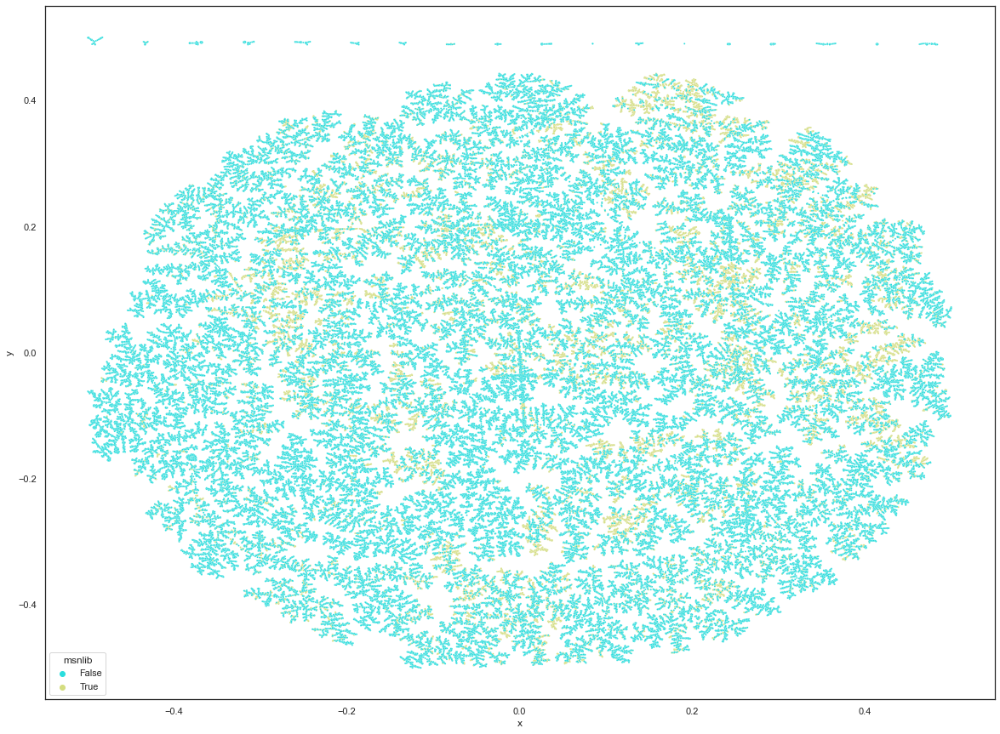

In [39]:
plt.figure(figsize=(20, 15))
sns.scatterplot(data=df, x='x', y='y', hue="msnlib", palette="rainbow", s=4)

<AxesSubplot:xlabel='x', ylabel='y'>

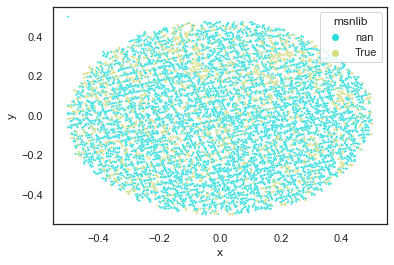

In [24]:
sns.scatterplot(data=df, x='x', y='y', hue="msnlib", palette="rainbow", s=4)